In [4]:
from PIL import Image
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline

In [403]:
def mcc(tp, tn, fp, fn):
    denom = tp*tn - fp*fn
    numer = np.sqrt((tp+fp)*(tp+fn)*(tn+fp)*(tn+fn))
    return denom/numer

def acc(tp, tn, fp, fn):
    return (tp+tn)/(tp+tn+fp+fn)

def f1(fp, fn, tp):
    return 2*tp/(2*tp+fp+fn)

In [37]:
def get_column_names(s, df):
    cols = df.columns.tolist()
    return list(filter(lambda x: x.startswith(s), cols))

In [27]:
def plot_image_grid(input_df, rows, cols, title=None, show_names=True):
    size = 3*max(rows, cols)
    fig, fr = plt.subplots(rows,cols, figsize=(size, size))
    fr = np.ravel(fr)

    # plot the images of some of these objects to see what the voters saw
    for i, name in enumerate(input_df['name'].head(rows*cols)):
        object_name = name
        path = '../image/thumbnails/{}_insp.png'.format(object_name)
        image = Image.open(path)
        fr[i].imshow(image)
        if show_names:
            fr[i].set_title(object_name)
        fr[i].set_axis_off()


    if title:
        fig.suptitle(title)
    fig.tight_layout()
    plt.show()

In [5]:
# df_votes.json is created in ./df_stacked.ipynb. 
#  Make sure to re-run that whenever we change something, 
#   otherwise we'll be working with stale data in this notebook
df_votes = pd.read_json('df_votes.json')
df = pd.read_json('df_stacked.json')

In [84]:
catalogue_targets = np.loadtxt('../../catalogue/sf_catalogue_targets.txt', dtype='str')

In [42]:
t0cols = get_column_names('T0', df_votes)
t1cols = get_column_names('T1', df_votes)

## Manually inspect a random subsample of objects to see how I rank among the users

In [12]:
num_objects = df_votes.shape[0]

In [216]:
def plot_random_with_constraints(df, rows=3, cols=3, show_names=False):
    num_objects = df.shape[0]
    indices = np.random.randint(0, num_objects, rows*cols)
    to_classify = df.iloc[indices]
    
    plot_image_grid(to_classify, rows, cols, show_names)
    
    return to_classify[['name', 'vote_count', *t0cols, *t1cols]]

### Find 9 random objects to inspect:

In [34]:
indices = np.random.randint(0, num_objects, 9)
to_classify = df_votes.iloc[indices]

### Plot image grid without names

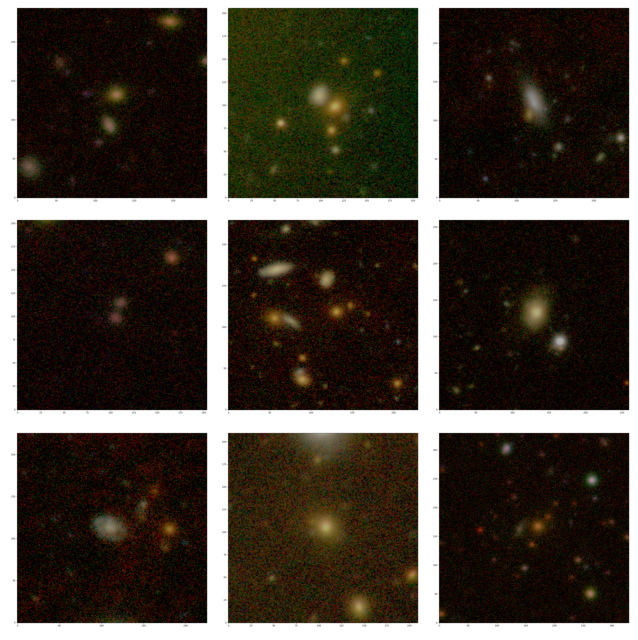

In [35]:
plot_image_grid(to_classify, 3, 3, show_names=False)

### Write down thoughts on classification:

- galaxy, bright
- group of objects
- galaxy, bright
- 2 galaxies -> group of objects?
- group of objects, exact center looks empty
- galaxy, bright
- galaxy, bright
- galaxy, bright
- group of objects

### Compare against other users

In [41]:
to_classify[['name', 'vote_count', *t0cols, *t1cols]]

,name,vote_count,T0,T0 % group of objects (cluster),T0 % galaxy,T0 % something else/empty center,T1,T1 % bright,T1 % fluffy
901,UDGcand_3424,32,"{'galaxy': 15, 'group of objects (cluster)': 1...",46.9,46.9,6.2,"{'Fluffy': 8, 'Bright': 4}",33.3,66.7
3190,UDGcand_5077,37,"{'group of objects (cluster)': 26, 'galaxy': 11}",70.3,29.7,0.0,"{'Bright': 4, 'Fluffy': 3}",57.1,42.9
5764,UDGcand_7034,32,"{'galaxy': 24, 'group of objects (cluster)': 8}",25.0,75.0,0.0,"{'Fluffy': 14, 'Bright': 2}",12.5,87.5
626,UDGcand_4568,37,"{'group of objects (cluster)': 26, 'galaxy': 6...",70.3,16.2,13.5,{'Fluffy': 5},0.0,100.0
266,UDGcand_266,30,"{'group of objects (cluster)': 27, 'galaxy': 3}",90.0,10.0,0.0,"{'Fluffy': 1, 'Bright': 1}",50.0,50.0
5817,UDGcand_1954,36,"{'galaxy': 30, 'group of objects (cluster)': 6}",16.7,83.3,0.0,"{'Bright': 19, 'Fluffy': 2}",90.5,9.5
275,UDGcand_381,26,"{'galaxy': 24, 'group of objects (cluster)': 2}",7.7,92.3,0.0,{'Fluffy': 20},0.0,100.0
5481,UDGcand_5668,36,"{'galaxy': 30, 'group of objects (cluster)': 3...",8.3,83.3,8.3,"{'Bright': 18, 'Fluffy': 2}",90.0,10.0
3682,UDGcand_3092,37,"{'group of objects (cluster)': 26, 'galaxy': 8...",70.3,21.6,8.1,"{'Bright': 2, 'Fluffy': 1}",66.7,33.3


Compare my answers against volunteers:
- galaxy, bright
    46.9 group
    46.9 galaxy
    33.3 bright, 
    66.7 fluffy
- group of objects
    70.3% group
- galaxy, bright
    75% galaxy, 
    87.5% fluffy
    12.5% bright
- 2 galaxies -> group of objects?
    70.3% group
- group of objects, exact center looks empty
    90% group
- galaxy, bright
    83.3% galaxy
        90.5% bright, 9.5% fluffy
- galaxy, bright
    92.3% galaxy, 100% fluffy
- galaxy, bright
    83.3% galaxy, 90% bright, 10% fluffy
- group of objects
    70.3% group

So, for the 9 objects, do the users agree with me?
1. user divide group vs. galaxy. also I picked bright though users go fluffy
2. yes
3. bright vs. fluffy
4. yes
5. yes
6. yes
7. bright vs. fluffy
8. yes
9. yes

Three objects where I picked bright, and user consensus is fluffy, instead.

### Again, and start streamlining process

In [47]:
g = 'group'
b = 'bright'
f = 'fluffy'
e = 'empty'

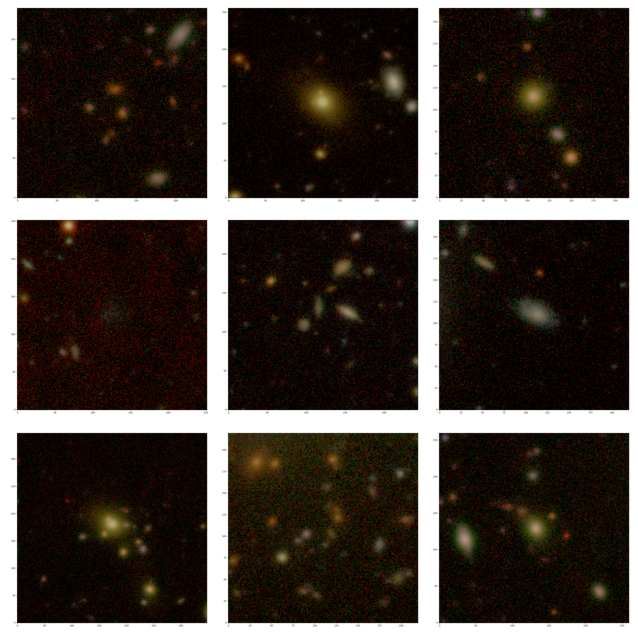

In [46]:
slice = plot_random_with_constraints(df_votes, 3, 3)

In [50]:
me = [g,b,b,f,g,b,g,g,b]
slice

,name,vote_count,T0,T0 % group of objects (cluster),T0 % galaxy,T0 % something else/empty center,T1,T1 % bright,T1 % fluffy
2489,UDGcand_4882,34,"{'group of objects (cluster)': 32, 'galaxy': 2}",94.1,5.9,0.0,{'Fluffy': 2},0.0,100.0
707,UDGcand_2040,33,"{'galaxy': 30, 'group of objects (cluster)': 3}",9.1,90.9,0.0,{'Bright': 23},100.0,0.0
2833,UDGcand_3322,35,"{'galaxy': 29, 'group of objects (cluster)': 4...",11.4,82.9,5.7,"{'Bright': 15, 'Fluffy': 4}",78.9,21.1
130,UDGcand_372,27,"{'something else/empty center': 23, 'group of ...",7.4,7.4,85.2,{'Fluffy': 2},0.0,100.0
5320,UDGcand_5591,34,"{'group of objects (cluster)': 23, 'galaxy': 11}",67.6,32.4,0.0,{'Fluffy': 9},0.0,100.0
4631,UDGcand_757,37,"{'galaxy': 34, 'group of objects (cluster)': 3}",8.1,91.9,0.0,"{'Fluffy': 18, 'Bright': 4}",18.2,81.8
3750,UDGcand_4974,36,"{'group of objects (cluster)': 30, 'galaxy': 4...",83.3,11.1,5.6,"{'Bright': 3, 'Fluffy': 1}",75.0,25.0
4514,UDGcand_2949,35,"{'group of objects (cluster)': 29, 'something ...",82.9,8.6,8.6,"{'Fluffy': 1, 'Bright': 1}",50.0,50.0
5302,UDGcand_4385,33,"{'galaxy': 17, 'group of objects (cluster)': 1...",45.5,51.5,3.0,"{'Bright': 8, 'Fluffy': 3}",72.7,27.3


match?
- yes
- yes
- yes
- fluffy vs empty
- yes
- bright vs fluffy
- yes
- yes
- yes

---

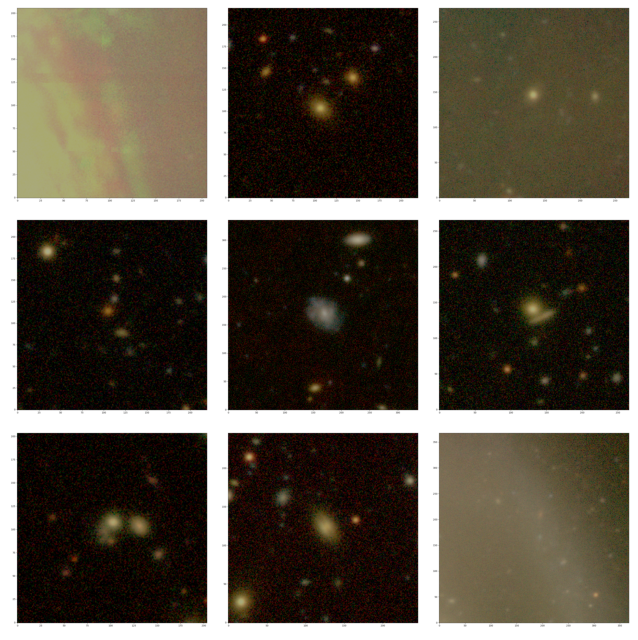

In [52]:
slice = plot_random_with_constraints(df_votes, 3, 3)

In [53]:
a = 'artifact'
me = [a,b,b,g,b,b,b,b,a]
slice

,name,vote_count,T0,T0 % group of objects (cluster),T0 % galaxy,T0 % something else/empty center,T1,T1 % bright,T1 % fluffy
5816,UDGcand_5501,32,"{'something else/empty center': 31, 'group of ...",3.1,0.0,96.9,{},NaN,NaN
6099,UDGcand_1723,35,"{'galaxy': 23, 'group of objects (cluster)': 1...",31.4,65.7,2.9,"{'Bright': 14, 'Fluffy': 3}",82.4,17.6
510,UDGcand_2519,34,"{'galaxy': 24, 'group of objects (cluster)': 5...",14.7,70.6,14.7,{'Bright': 16},100.0,0.0
5679,UDGcand_868,36,"{'group of objects (cluster)': 25, 'galaxy': 11}",69.4,30.6,0.0,"{'Fluffy': 4, 'Bright': 3}",42.9,57.1
148,UDGcand_21,28,"{'galaxy': 25, 'group of objects (cluster)': 2...",7.1,89.3,3.6,"{'Fluffy': 16, 'Bright': 5}",23.8,76.2
4568,UDGcand_6494,38,"{'galaxy': 25, 'group of objects (cluster)': 13}",34.2,65.8,0.0,{'Bright': 14},100.0,0.0
2738,UDGcand_1196,34,"{'group of objects (cluster)': 20, 'galaxy': 1...",58.8,32.4,8.8,"{'Bright': 4, 'Fluffy': 2}",66.7,33.3
4371,UDGcand_2595,36,"{'galaxy': 32, 'group of objects (cluster)': 4}",11.1,88.9,0.0,"{'Fluffy': 20, 'Bright': 3}",13.0,87.0
4104,UDGcand_1877,36,"{'something else/empty center': 28, 'group of ...",16.7,5.6,77.8,{},NaN,NaN


- yes
- yes
- yes
- yes
- bright vs fluffy
- bright
- bright vs. group
- bright vs fluffy
- yes

---

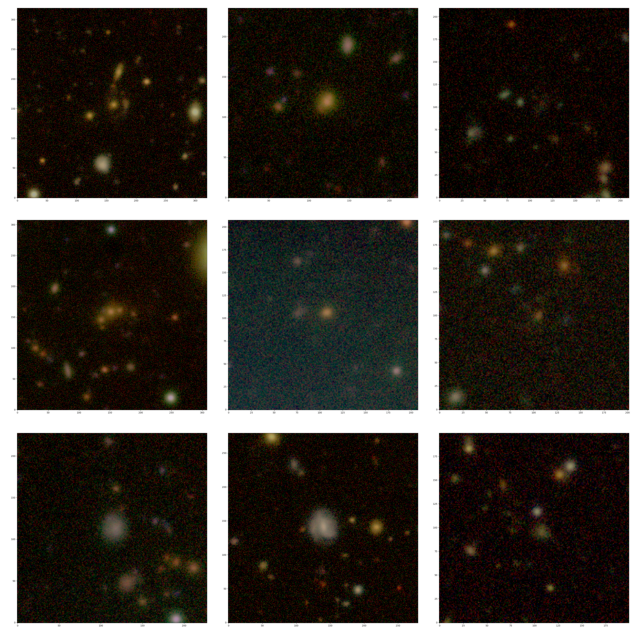

In [54]:
slice_1 = plot_random_with_constraints(df_votes, 3, 3)

In [86]:
s1 = [g, b, 'f/e', g, 'b/g', e, f, b, g]
slice_1
# [g, f, g/e, g, b/f, f, f, g]  # users

,name,vote_count,T0,T0 % group of objects (cluster),T0 % galaxy,T0 % something else/empty center,T1,T1 % bright,T1 % fluffy
852,UDGcand_1297,33,"{'group of objects (cluster)': 22, 'galaxy': 1...",66.7,30.3,3.0,"{'Bright': 4, 'Fluffy': 2}",66.7,33.3
6175,UDGcand_4739,39,"{'galaxy': 31, 'group of objects (cluster)': 5...",12.8,79.5,7.7,"{'Fluffy': 12, 'Bright': 8}",40.0,60.0
4658,UDGcand_892,35,"{'group of objects (cluster)': 20, 'something ...",57.1,2.9,40.0,{'Fluffy': 1},0.0,100.0
5792,UDGcand_3393,35,"{'group of objects (cluster)': 33, 'galaxy': 2}",94.3,5.7,0.0,{'Fluffy': 1},0.0,100.0
1798,UDGcand_3703,37,"{'galaxy': 27, 'group of objects (cluster)': 7...",18.9,73.0,8.1,"{'Bright': 10, 'Fluffy': 9}",52.6,47.4
3546,UDGcand_6400,35,"{'galaxy': 17, 'something else/empty center': ...",17.1,48.6,34.3,"{'Fluffy': 11, 'Bright': 1}",8.3,91.7
4906,UDGcand_2974,36,"{'galaxy': 26, 'group of objects (cluster)': 8...",22.2,72.2,5.6,"{'Fluffy': 18, 'Bright': 1}",5.3,94.7
5737,UDGcand_1371,35,"{'galaxy': 31, 'group of objects (cluster)': 3...",8.6,88.6,2.9,"{'Fluffy': 19, 'Bright': 2}",9.5,90.5
2492,UDGcand_6804,39,"{'group of objects (cluster)': 26, 'galaxy': 1...",66.7,25.6,7.7,"{'Fluffy': 7, 'Bright': 1}",12.5,87.5


--- 

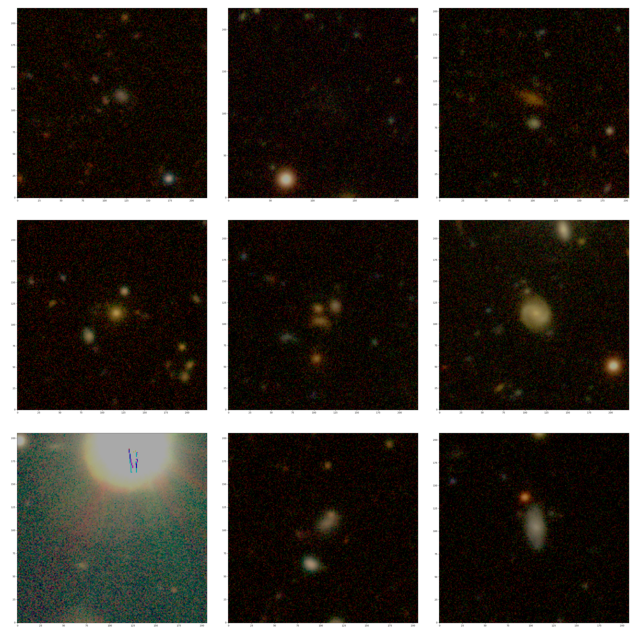

In [57]:
slice_2 = plot_random_with_constraints(df_votes, 3, 3)

In [97]:
s2 = ['f/g', e, b, b, g, b, a, g, b]
# them:  g, e, f, b, g, f, e, f/g, f
slice_2

,name,vote_count,T0,T0 % group of objects (cluster),T0 % galaxy,T0 % something else/empty center,T1,T1 % bright,T1 % fluffy
4488,UDGcand_5909,37,"{'group of objects (cluster)': 24, 'galaxy': 8...",64.9,21.6,13.5,"{'Fluffy': 3, 'Bright': 1}",25.0,75.0
1736,UDGcand_6822,37,"{'something else/empty center': 35, 'galaxy': 2}",0.0,5.4,94.6,"{'Fluffy': 1, 'Bright': 1}",50.0,50.0
2204,UDGcand_1647,35,"{'galaxy': 22, 'group of objects (cluster)': 7...",20.0,62.9,17.1,"{'Fluffy': 15, 'Bright': 1}",6.2,93.8
5788,UDGcand_6083,35,"{'galaxy': 23, 'group of objects (cluster)': 12}",34.3,65.7,0.0,"{'Bright': 11, 'Fluffy': 4}",73.3,26.7
6163,UDGcand_2177,36,"{'group of objects (cluster)': 30, 'galaxy': 4...",83.3,11.1,5.6,{'Fluffy': 2},0.0,100.0
3144,UDGcand_5284,35,"{'galaxy': 33, 'group of objects (cluster)': 1...",2.9,94.3,2.9,"{'Fluffy': 15, 'Bright': 8}",34.8,65.2
1553,UDGcand_2683,33,"{'something else/empty center': 27, 'galaxy': ...",3.0,15.2,81.8,{'Bright': 4},100.0,0.0
1897,UDGcand_6136,38,"{'galaxy': 17, 'group of objects (cluster)': 1...",42.1,44.7,13.2,{'Fluffy': 12},0.0,100.0
822,UDGcand_2044,37,"{'galaxy': 34, 'group of objects (cluster)': 3}",8.1,91.9,0.0,{'Fluffy': 20},0.0,100.0


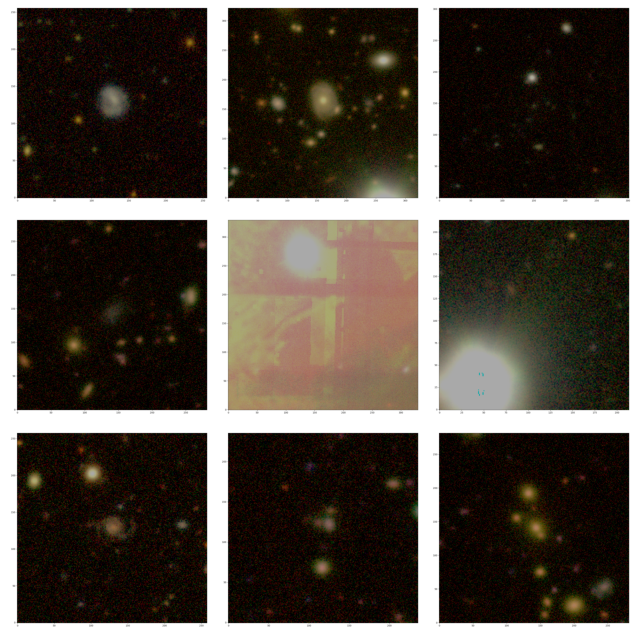

In [59]:
slice_3 = plot_random_with_constraints(df_votes, 3, 3)

In [98]:
s3 = [b, b, e, f, a, a, b, g, 'g/b']
# them f, b, g/e, e/f, e, e, f, g, g
slice_3

,name,vote_count,T0,T0 % group of objects (cluster),T0 % galaxy,T0 % something else/empty center,T1,T1 % bright,T1 % fluffy
4852,UDGcand_6856,37,"{'galaxy': 33, 'group of objects (cluster)': 4}",10.8,89.2,0.0,"{'Fluffy': 20, 'Bright': 1}",4.8,95.2
4589,UDGcand_5920,34,"{'galaxy': 18, 'group of objects (cluster)': 1...",38.2,52.9,8.8,"{'Bright': 8, 'Fluffy': 5}",61.5,38.5
5053,UDGcand_867,32,"{'group of objects (cluster)': 13, 'something ...",40.6,28.1,31.2,"{'Bright': 4, 'Fluffy': 1}",80.0,20.0
6232,UDGcand_3210,37,"{'something else/empty center': 15, 'galaxy': ...",24.3,35.1,40.5,{'Fluffy': 7},0.0,100.0
3231,UDGcand_5707,35,"{'something else/empty center': 34, 'galaxy': 1}",0.0,2.9,97.1,{},NaN,NaN
1328,UDGcand_3922,35,"{'something else/empty center': 28, 'galaxy': ...",8.6,11.4,80.0,{'Bright': 4},100.0,0.0
1049,UDGcand_1282,37,"{'galaxy': 30, 'group of objects (cluster)': 6...",16.2,81.1,2.7,"{'Fluffy': 15, 'Bright': 2}",11.8,88.2
1041,UDGcand_4318,34,"{'group of objects (cluster)': 29, 'something ...",85.3,5.9,8.8,{'Fluffy': 1},0.0,100.0
3417,UDGcand_4963,37,"{'group of objects (cluster)': 33, 'galaxy': 4}",89.2,10.8,0.0,{'Bright': 3},100.0,0.0


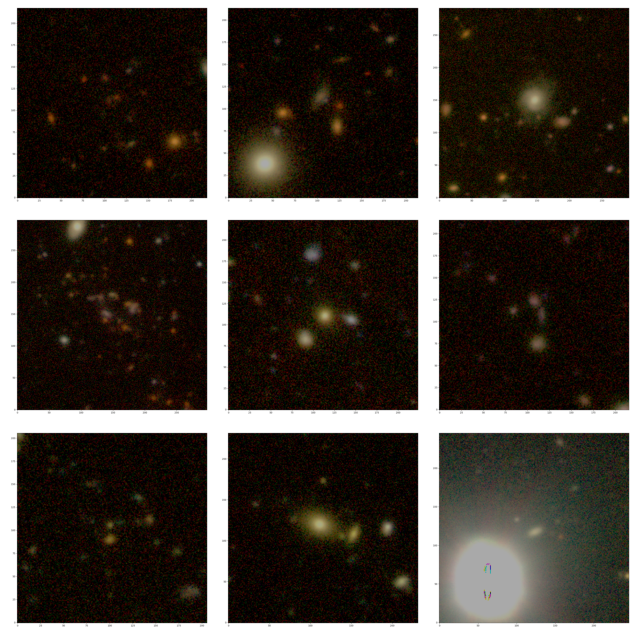

In [61]:
slice_4 = plot_random_with_constraints(df_votes, 3, 3)

In [89]:
s4 = [g, g, b, g, b, g, g, b, a]
# them g, g, b, g, g, g, g, b, f/e
slice_4

,name,vote_count,T0,T0 % group of objects (cluster),T0 % galaxy,T0 % something else/empty center,T1,T1 % bright,T1 % fluffy
4442,UDGcand_5999,35,"{'group of objects (cluster)': 18, 'something ...",51.4,14.3,34.3,{'Fluffy': 3},0.0,100.0
3019,UDGcand_1179,35,"{'group of objects (cluster)': 18, 'galaxy': 1...",51.4,40.0,8.6,"{'Fluffy': 8, 'Bright': 2}",20.0,80.0
1716,UDGcand_6141,35,"{'galaxy': 27, 'group of objects (cluster)': 6...",17.1,77.1,5.7,"{'Bright': 12, 'Fluffy': 5}",70.6,29.4
3646,UDGcand_1882,37,"{'group of objects (cluster)': 34, 'galaxy': 3}",91.9,8.1,0.0,{'Fluffy': 1},0.0,100.0
3261,UDGcand_7187,32,"{'group of objects (cluster)': 20, 'galaxy': 1...",62.5,34.4,3.1,"{'Bright': 7, 'Fluffy': 1}",87.5,12.5
6128,UDGcand_3531,30,"{'group of objects (cluster)': 25, 'something ...",83.3,3.3,13.3,{'Fluffy': 1},0.0,100.0
5139,UDGcand_715,35,"{'group of objects (cluster)': 28, 'galaxy': 5...",80.0,14.3,5.7,{'Fluffy': 3},0.0,100.0
5937,UDGcand_974,33,"{'galaxy': 25, 'group of objects (cluster)': 7...",21.2,75.8,3.0,"{'Bright': 17, 'Fluffy': 1}",94.4,5.6
2186,UDGcand_4090,36,"{'something else/empty center': 17, 'galaxy': ...",8.3,44.4,47.2,"{'Fluffy': 7, 'Bright': 4}",36.4,63.6


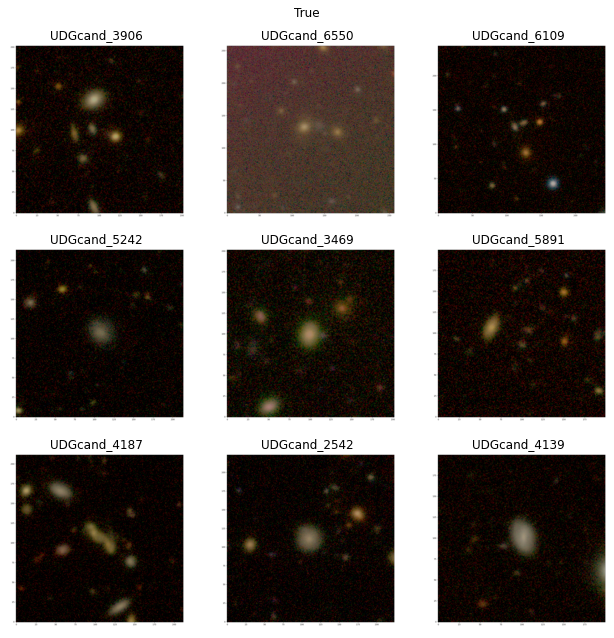

In [64]:
slice_5 = plot_random_with_constraints(df_votes, 3, 3, show_names=True)

In [90]:
s5 = [g, g, g, f, b, g, g, b, f]
# g, g, g, f, f, g, g, f, f
slice_5

,name,vote_count,T0,T0 % group of objects (cluster),T0 % galaxy,T0 % something else/empty center,T1,T1 % bright,T1 % fluffy
699,UDGcand_3906,35,"{'group of objects (cluster)': 26, 'galaxy': 9}",74.3,25.7,0.0,"{'Fluffy': 6, 'Bright': 1}",14.3,85.7
4163,UDGcand_6550,33,"{'group of objects (cluster)': 17, 'galaxy': 1...",51.5,45.5,3.0,"{'Fluffy': 7, 'Bright': 5}",41.7,58.3
5236,UDGcand_6109,36,"{'group of objects (cluster)': 34, 'something ...",94.4,2.8,2.8,{},NaN,NaN
4956,UDGcand_5242,36,"{'galaxy': 34, 'group of objects (cluster)': 2}",5.6,94.4,0.0,"{'Fluffy': 22, 'Bright': 2}",8.3,91.7
3662,UDGcand_3469,36,"{'galaxy': 33, 'group of objects (cluster)': 3}",8.3,91.7,0.0,"{'Fluffy': 18, 'Bright': 7}",28.0,72.0
2695,UDGcand_5891,37,"{'group of objects (cluster)': 20, 'something ...",54.1,18.9,27.0,{'Fluffy': 4},0.0,100.0
5056,UDGcand_4187,38,"{'group of objects (cluster)': 24, 'galaxy': 14}",63.2,36.8,0.0,"{'Fluffy': 7, 'Bright': 2}",22.2,77.8
4653,UDGcand_2542,34,"{'galaxy': 30, 'group of objects (cluster)': 2...",5.9,88.2,5.9,"{'Fluffy': 16, 'Bright': 5}",23.8,76.2
2726,UDGcand_4139,36,{'galaxy': 36},0.0,100.0,0.0,"{'Fluffy': 19, 'Bright': 4}",17.4,82.6


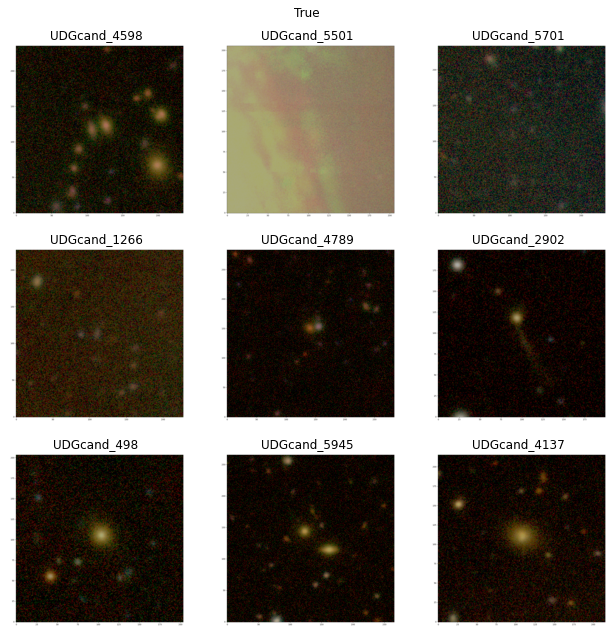

In [66]:
slice_6 = plot_random_with_constraints(df_votes, 3, 3, show_names=True)

In [91]:
s6 = [g, a, e, g, g, b, b, 'b/g', b]
# g, e, e, e, g, b, b, g,   b
slice_6

,name,vote_count,T0,T0 % group of objects (cluster),T0 % galaxy,T0 % something else/empty center,T1,T1 % bright,T1 % fluffy
5491,UDGcand_4598,35,"{'group of objects (cluster)': 28, 'galaxy': 5...",80.0,14.3,5.7,{'Fluffy': 3},0.0,100.0
5816,UDGcand_5501,32,"{'something else/empty center': 31, 'group of ...",3.1,0.0,96.9,{},NaN,NaN
3354,UDGcand_5701,34,"{'something else/empty center': 28, 'group of ...",17.6,0.0,82.4,{},NaN,NaN
5047,UDGcand_1266,36,"{'something else/empty center': 15, 'group of ...",38.9,19.4,41.7,{'Fluffy': 4},0.0,100.0
5457,UDGcand_4789,38,"{'group of objects (cluster)': 35, 'galaxy': 2...",92.1,5.3,2.6,{},NaN,NaN
4757,UDGcand_2902,28,"{'galaxy': 19, 'group of objects (cluster)': 5...",17.9,67.9,14.3,"{'Bright': 10, 'Fluffy': 5}",66.7,33.3
3441,UDGcand_498,34,"{'galaxy': 30, 'group of objects (cluster)': 3...",8.8,88.2,2.9,"{'Bright': 18, 'Fluffy': 4}",81.8,18.2
3469,UDGcand_5945,38,"{'group of objects (cluster)': 18, 'galaxy': 1...",47.4,39.5,13.2,"{'Bright': 5, 'Fluffy': 4}",55.6,44.4
348,UDGcand_4137,34,{'galaxy': 34},0.0,100.0,0.0,"{'Bright': 15, 'Fluffy': 10}",60.0,40.0


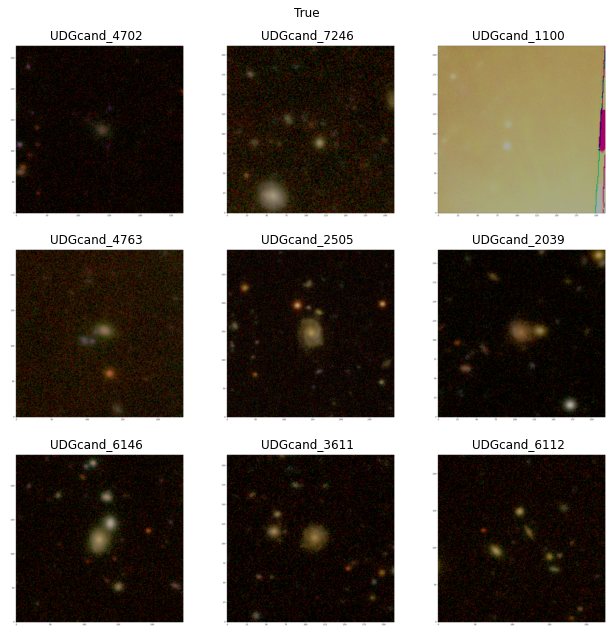

In [68]:
slice_7 = plot_random_with_constraints(df_votes, 3, 3, show_names=True)

In [92]:
s7 = [f, g, a, g, b, b, g, b, g]
# f, g, e, g/f, f/b, g/f, b/f, f, g
slice_7

,name,vote_count,T0,T0 % group of objects (cluster),T0 % galaxy,T0 % something else/empty center,T1,T1 % bright,T1 % fluffy
3095,UDGcand_4702,37,"{'galaxy': 19, 'something else/empty center': ...",10.8,51.4,37.8,"{'Fluffy': 10, 'Bright': 1}",9.1,90.9
6182,UDGcand_7246,35,"{'group of objects (cluster)': 18, 'something ...",51.4,14.3,34.3,"{'Fluffy': 2, 'Bright': 1}",33.3,66.7
3043,UDGcand_1100,34,"{'something else/empty center': 27, 'group of ...",14.7,5.9,79.4,{'Bright': 2},100.0,0.0
684,UDGcand_4763,39,"{'group of objects (cluster)': 20, 'galaxy': 1...",51.3,46.2,2.6,"{'Fluffy': 9, 'Bright': 1}",10.0,90.0
5941,UDGcand_2505,36,"{'galaxy': 34, 'group of objects (cluster)': 2}",5.6,94.4,0.0,"{'Fluffy': 12, 'Bright': 10}",45.5,54.5
1050,UDGcand_2039,37,"{'galaxy': 19, 'group of objects (cluster)': 18}",48.6,51.4,0.0,{'Fluffy': 10},0.0,100.0
3807,UDGcand_6146,36,"{'galaxy': 20, 'group of objects (cluster)': 16}",44.4,55.6,0.0,"{'Fluffy': 7, 'Bright': 7}",50.0,50.0
3487,UDGcand_3611,33,"{'galaxy': 27, 'group of objects (cluster)': 5...",15.2,81.8,3.0,"{'Fluffy': 19, 'Bright': 2}",9.5,90.5
1117,UDGcand_6112,36,"{'group of objects (cluster)': 28, 'galaxy': 4...",77.8,11.1,11.1,{'Fluffy': 2},0.0,100.0


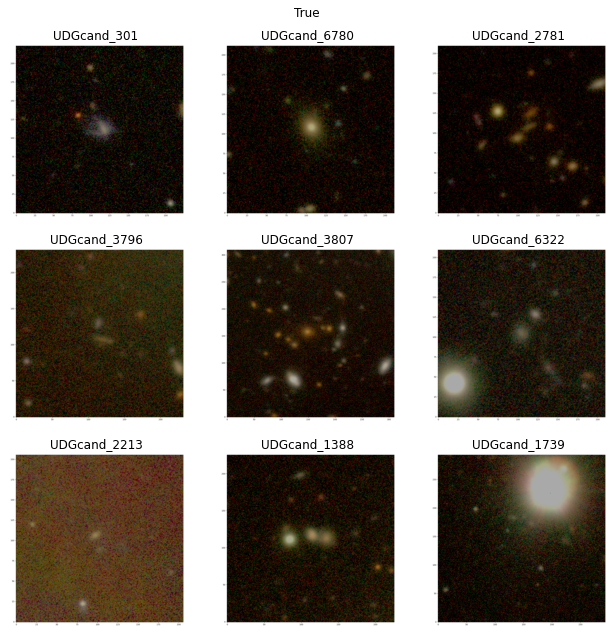

In [70]:
slice_8 = plot_random_with_constraints(df_votes, 3, 3, show_names=True)

In [100]:
# first one has a tidal structure
s8 = [f, b, g, g, g, 'f/g', g, g, a]
# f,                b, g, g, g, f,   f/e, g, e
slice_8

,name,vote_count,T0,T0 % group of objects (cluster),T0 % galaxy,T0 % something else/empty center,T1,T1 % bright,T1 % fluffy
84,UDGcand_301,25,"{'galaxy': 17, 'group of objects (cluster)': 7...",28.0,68.0,4.0,"{'Fluffy': 13, 'Bright': 1}",7.1,92.9
3471,UDGcand_6780,34,"{'galaxy': 28, 'something else/empty center': ...",8.8,82.4,8.8,"{'Bright': 16, 'Fluffy': 3}",84.2,15.8
2392,UDGcand_2781,40,"{'group of objects (cluster)': 34, 'galaxy': 5...",85.0,12.5,2.5,{'Fluffy': 4},0.0,100.0
6202,UDGcand_3796,39,"{'group of objects (cluster)': 19, 'galaxy': 1...",48.7,33.3,17.9,{'Fluffy': 5},0.0,100.0
2746,UDGcand_3807,35,"{'group of objects (cluster)': 29, 'galaxy': 4...",82.9,11.4,5.7,{'Bright': 3},100.0,0.0
2042,UDGcand_6322,32,"{'galaxy': 21, 'group of objects (cluster)': 1...",31.2,65.6,3.1,"{'Fluffy': 14, 'Bright': 1}",6.7,93.3
835,UDGcand_2213,37,"{'galaxy': 18, 'something else/empty center': ...",8.1,48.6,43.2,"{'Fluffy': 10, 'Bright': 1}",9.1,90.9
6265,UDGcand_1388,37,"{'group of objects (cluster)': 31, 'galaxy': 4...",83.8,10.8,5.4,{'Fluffy': 4},0.0,100.0
4803,UDGcand_1739,34,"{'something else/empty center': 22, 'group of ...",23.5,11.8,64.7,{'Bright': 4},100.0,0.0


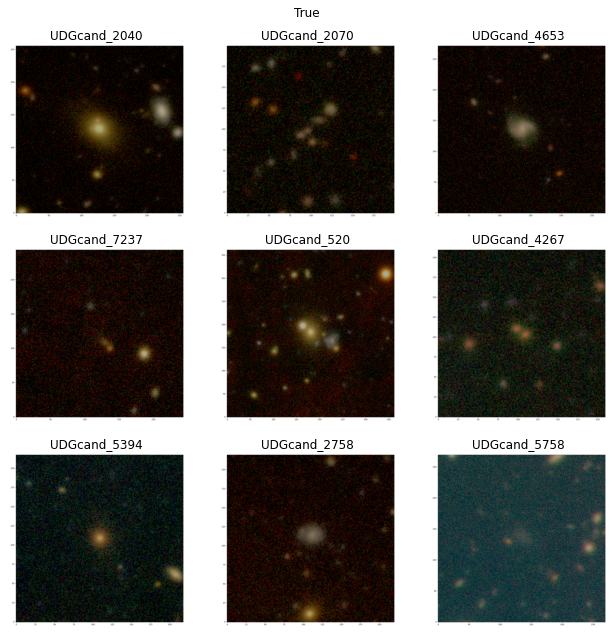

In [72]:
slice_9 = plot_random_with_constraints(df_votes, 3, 3, show_names=True)

In [94]:
s9 = [b, g, f, e, g, g, b, f, 'f/g']
# b, g, f, e, g, g, b, f, e
slice_9

,name,vote_count,T0,T0 % group of objects (cluster),T0 % galaxy,T0 % something else/empty center,T1,T1 % bright,T1 % fluffy
707,UDGcand_2040,33,"{'galaxy': 30, 'group of objects (cluster)': 3}",9.1,90.9,0.0,{'Bright': 23},100.0,0.0
5897,UDGcand_2070,36,"{'group of objects (cluster)': 31, 'galaxy': 3...",86.1,8.3,5.6,{'Fluffy': 2},0.0,100.0
3072,UDGcand_4653,35,"{'galaxy': 34, 'group of objects (cluster)': 1}",2.9,97.1,0.0,"{'Fluffy': 20, 'Bright': 3}",13.0,87.0
413,UDGcand_7237,32,"{'something else/empty center': 16, 'group of ...",37.5,12.5,50.0,{'Fluffy': 3},0.0,100.0
5940,UDGcand_520,36,"{'group of objects (cluster)': 29, 'galaxy': 6...",80.6,16.7,2.8,"{'Bright': 4, 'Fluffy': 2}",66.7,33.3
4176,UDGcand_4267,35,"{'group of objects (cluster)': 27, 'something ...",77.1,11.4,11.4,"{'Fluffy': 3, 'Bright': 1}",25.0,75.0
4575,UDGcand_5394,39,"{'galaxy': 37, 'group of objects (cluster)': 2}",5.1,94.9,0.0,"{'Bright': 22, 'Fluffy': 2}",91.7,8.3
5526,UDGcand_2758,37,"{'galaxy': 30, 'group of objects (cluster)': 4...",10.8,81.1,8.1,"{'Fluffy': 18, 'Bright': 1}",5.3,94.7
5230,UDGcand_5758,37,"{'something else/empty center': 31, 'group of ...",10.8,5.4,83.8,{'Fluffy': 1},0.0,100.0


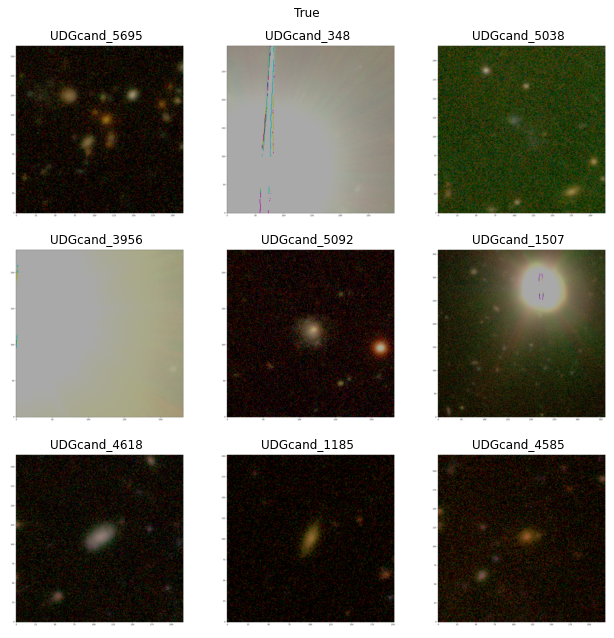

In [74]:
slice_10 = plot_random_with_constraints(df_votes, 3, 3, show_names=True)

In [95]:
s10 = [g, a, 'g/e/f', a, b, a, f, f, b]
# g, e, e,     e, b, e, f, f, f
slice_10

,name,vote_count,T0,T0 % group of objects (cluster),T0 % galaxy,T0 % something else/empty center,T1,T1 % bright,T1 % fluffy
353,UDGcand_5695,39,"{'group of objects (cluster)': 31, 'galaxy': 7...",79.5,17.9,2.6,"{'Bright': 2, 'Fluffy': 1}",66.7,33.3
186,UDGcand_348,23,{'something else/empty center': 23},0.0,0.0,100.0,{},NaN,NaN
2094,UDGcand_5038,37,"{'something else/empty center': 27, 'group of ...",18.9,8.1,73.0,{'Fluffy': 2},0.0,100.0
357,UDGcand_3956,34,{'something else/empty center': 34},0.0,0.0,100.0,{},NaN,NaN
5851,UDGcand_5092,35,"{'galaxy': 31, 'group of objects (cluster)': 3...",8.6,88.6,2.9,"{'Bright': 14, 'Fluffy': 7}",66.7,33.3
5115,UDGcand_1507,34,"{'something else/empty center': 27, 'group of ...",11.8,8.8,79.4,{'Bright': 3},100.0,0.0
3767,UDGcand_4618,35,"{'galaxy': 33, 'group of objects (cluster)': 1...",2.9,94.3,2.9,"{'Fluffy': 20, 'Bright': 3}",13.0,87.0
3963,UDGcand_1185,36,"{'galaxy': 34, 'group of objects (cluster)': 1...",2.8,94.4,2.8,"{'Fluffy': 16, 'Bright': 6}",27.3,72.7
3449,UDGcand_4585,34,"{'galaxy': 26, 'something else/empty center': ...",11.8,76.5,11.8,"{'Fluffy': 11, 'Bright': 8}",42.1,57.9


## Combine slices and check how I performed on any catalogue targets I may have been shown

In [77]:
# combine all slices
s = [slice_1, slice_2, slice_3, slice_4, slice_5, slice_6, slice_7, slice_8, slice_9, slice_10]

In [192]:
def combine_slices(array):
    slices = array[0]
    for i in range(1, len(array)):
        slices = slices.append(array[i])
        
    return slices

In [82]:
slices = slice_1
for i in range(1,len(s)):
    slices = slices.append(s[i])

In [107]:
# find the catalogue targets
sliced_in_cat = slices.query('name.isin(@catalogue_targets)')

In [127]:
# indices of the catalogue targets in `slices`
cat_idc = np.where(slices['name'].isin(catalogue_targets))

In [128]:
# combine my answers into a flat array
my_answers = np.concatenate([s1, s2, s3, s4, s5, s6, s7, s8, s9, s10])

In [129]:
# check what I answered for the catalogue targets
my_answers[cat_idc]

array(['f/e', 'fluffy', 'empty', 'fluffy', 'f/g'], dtype='<U8')

In [167]:
idc = []

match = ['/f', 'f/', 'fluffy']
for substr in match:
    idc.append(np.where(np.char.find(my_answers, substr) > -1))
    
idc = [j for sublist in idc for i in sublist for j in i]

In [196]:
def my_fluf_idc(array):
    idc = []

    match = ['/f', 'f/', 'fluffy']
    for substr in match:
        idc.append(np.where(np.char.find(array, substr) > -1))

    idc = [j for sublist in idc for i in sublist for j in i]
    
    return idc

In [170]:
my_answers[idc]

array(['g/e/f', 'f/e', 'f/g', 'f/g', 'f/g', 'fluffy', 'fluffy', 'fluffy',
       'fluffy', 'fluffy', 'fluffy', 'fluffy', 'fluffy', 'fluffy',
       'fluffy'], dtype='<U8')

In [169]:
slices.iloc[idc]

,name,vote_count,T0,T0 % group of objects (cluster),T0 % galaxy,T0 % something else/empty center,T1,T1 % bright,T1 % fluffy
2094,UDGcand_5038,37,"{'something else/empty center': 27, 'group of ...",18.9,8.1,73.0,{'Fluffy': 2},0.0,100.0
4658,UDGcand_892,35,"{'group of objects (cluster)': 20, 'something ...",57.1,2.9,40.0,{'Fluffy': 1},0.0,100.0
4488,UDGcand_5909,37,"{'group of objects (cluster)': 24, 'galaxy': 8...",64.9,21.6,13.5,"{'Fluffy': 3, 'Bright': 1}",25.0,75.0
2042,UDGcand_6322,32,"{'galaxy': 21, 'group of objects (cluster)': 1...",31.2,65.6,3.1,"{'Fluffy': 14, 'Bright': 1}",6.7,93.3
5230,UDGcand_5758,37,"{'something else/empty center': 31, 'group of ...",10.8,5.4,83.8,{'Fluffy': 1},0.0,100.0
4906,UDGcand_2974,36,"{'galaxy': 26, 'group of objects (cluster)': 8...",22.2,72.2,5.6,"{'Fluffy': 18, 'Bright': 1}",5.3,94.7
6232,UDGcand_3210,37,"{'something else/empty center': 15, 'galaxy': ...",24.3,35.1,40.5,{'Fluffy': 7},0.0,100.0
4956,UDGcand_5242,36,"{'galaxy': 34, 'group of objects (cluster)': 2}",5.6,94.4,0.0,"{'Fluffy': 22, 'Bright': 2}",8.3,91.7
2726,UDGcand_4139,36,{'galaxy': 36},0.0,100.0,0.0,"{'Fluffy': 19, 'Bright': 4}",17.4,82.6
3095,UDGcand_4702,37,"{'galaxy': 19, 'something else/empty center': ...",10.8,51.4,37.8,"{'Fluffy': 10, 'Bright': 1}",9.1,90.9


## Plot images of catalogue targets we've been shown for post-classification reference:

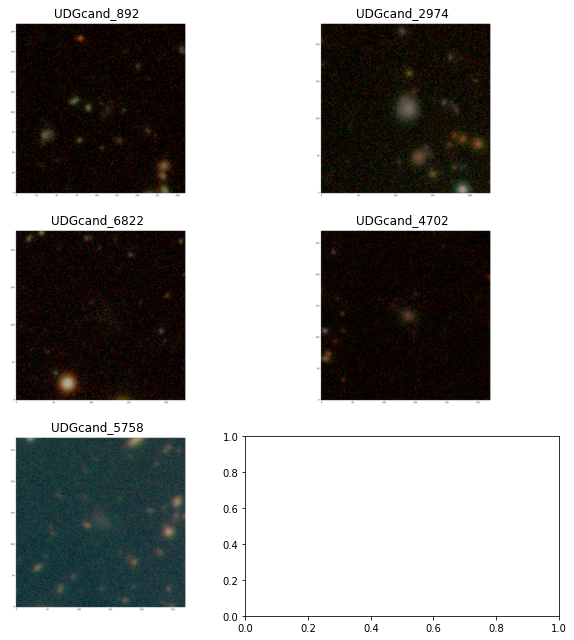

In [131]:
plot_image_grid(sliced_in_cat, 3, 2, show_names=True)

--- 

Take subsample of objects where users vote galaxy (>75%) + fluffy (>75%)

Eventually, we should do this also for objects that survive selection cuts, but we'll get to that later

In [172]:
t0cols, t1cols

(['T0',
  'T0 % group of objects (cluster)',
  'T0 % galaxy',
  'T0 % something else/empty center'],
 ['T1', 'T1 % bright', 'T1 % fluffy'])

In [209]:
consensus_fluffy = df_votes.query("`T0 % galaxy` > 75 & `T1 % fluffy` > 75")

In [210]:
consensus_fluffy.shape[0]

1016

In [213]:
consensus_fluffy[[*t0cols, *t1cols]]

,T0,T0 % group of objects (cluster),T0 % galaxy,T0 % something else/empty center,T1,T1 % bright,T1 % fluffy
0,"{'galaxy': 25, 'group of objects (cluster)': 1}",3.8,96.2,0.0,"{'Fluffy': 18, 'Bright': 3}",14.3,85.7
3,"{'galaxy': 28, 'group of objects (cluster)': 1}",3.4,96.6,0.0,"{'Fluffy': 19, 'Bright': 6}",24.0,76.0
5,"{'galaxy': 26, 'group of objects (cluster)': 2...",6.7,86.7,6.7,"{'Fluffy': 18, 'Bright': 3}",14.3,85.7
18,"{'galaxy': 21, 'group of objects (cluster)': 3...",12.0,84.0,4.0,"{'Fluffy': 17, 'Bright': 1}",5.6,94.4
31,"{'galaxy': 18, 'group of objects (cluster)': 5}",21.7,78.3,0.0,"{'Fluffy': 13, 'Bright': 1}",7.1,92.9
...,...,...,...,...,...,...,...
6340,"{'galaxy': 35, 'group of objects (cluster)': 2...",5.3,92.1,2.6,{'Fluffy': 22},0.0,100.0
6342,"{'galaxy': 30, 'group of objects (cluster)': 7...",17.9,76.9,5.1,{'Fluffy': 17},0.0,100.0
6344,"{'galaxy': 29, 'group of objects (cluster)': 2...",6.2,90.6,3.1,"{'Fluffy': 18, 'Bright': 3}",14.3,85.7
6345,"{'galaxy': 31, 'group of objects (cluster)': 2...",5.9,91.2,2.9,"{'Fluffy': 20, 'Bright': 2}",9.1,90.9


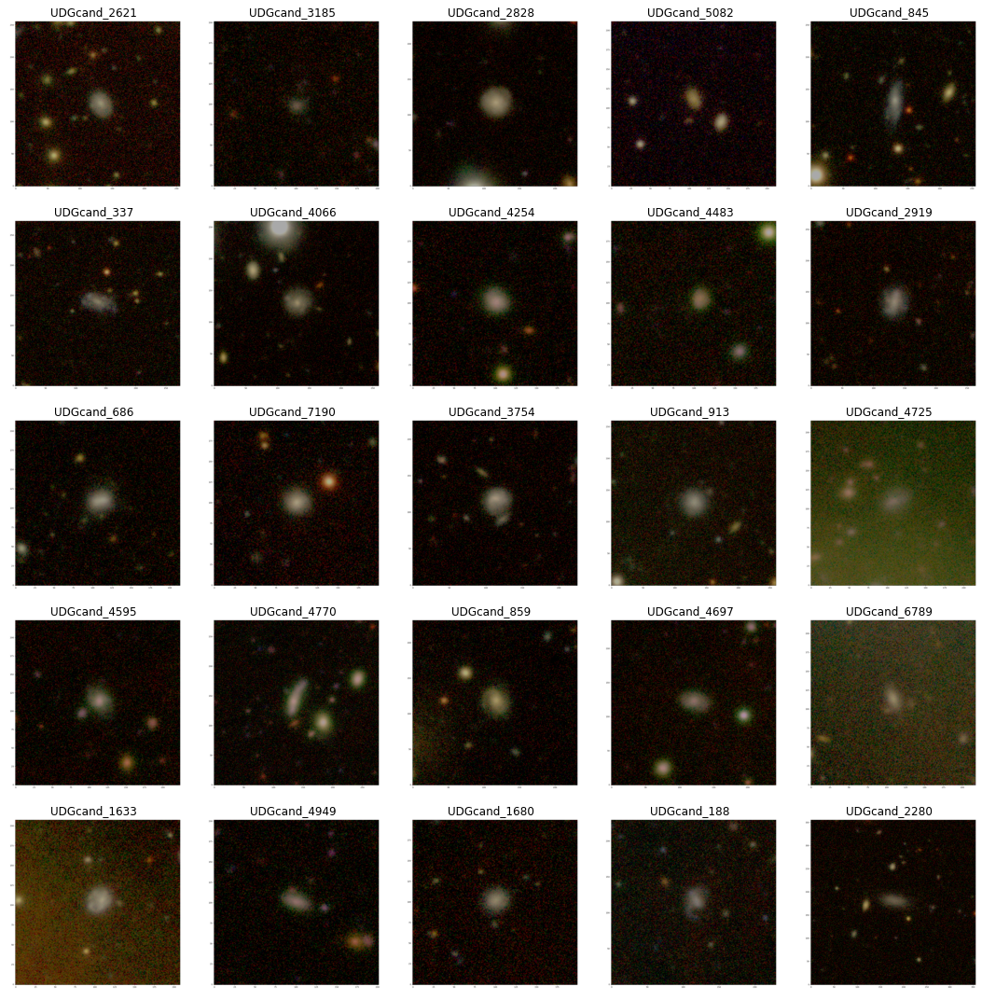

In [270]:
f1 = plot_random_with_constraints(consensus_fluffy, 5, 5)

In [290]:
mf1 = np.array([1, 14, 24])

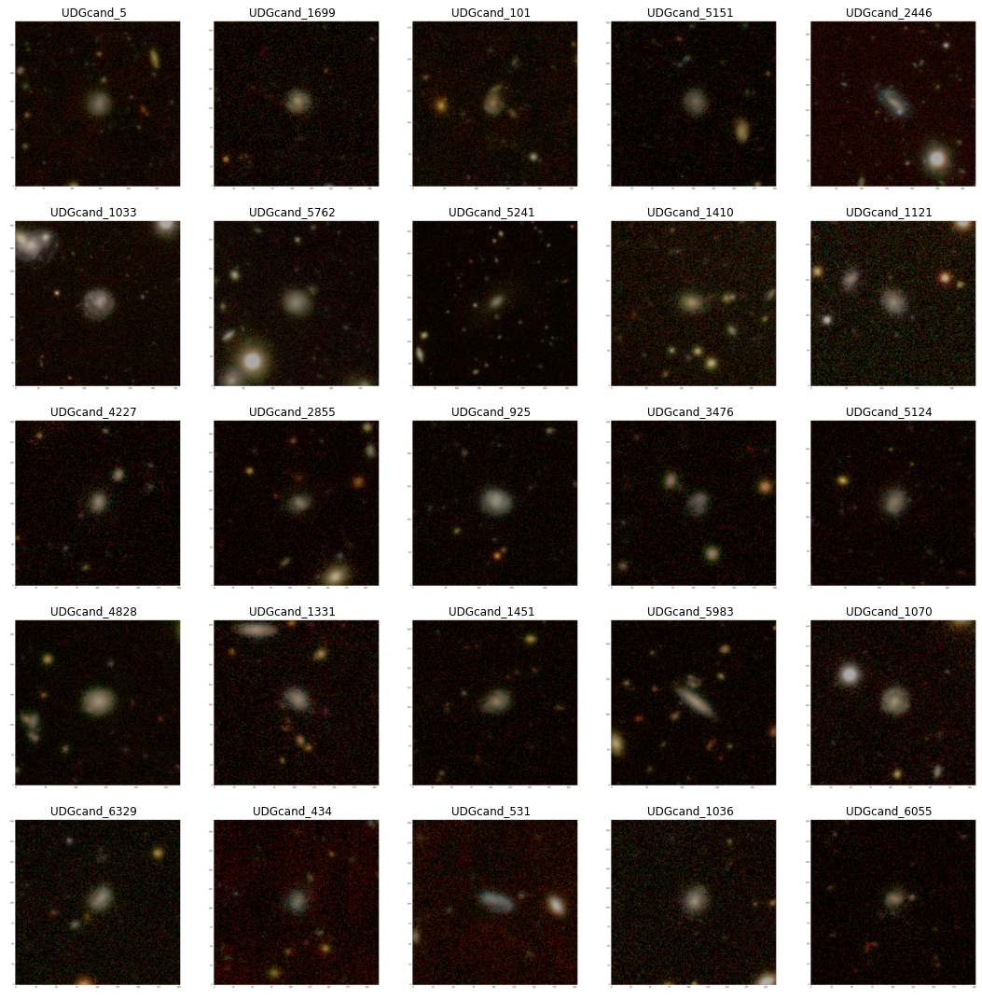

In [271]:
f2 = plot_random_with_constraints(consensus_fluffy, 5, 5)

In [289]:
mf2 = np.array([4, 13])

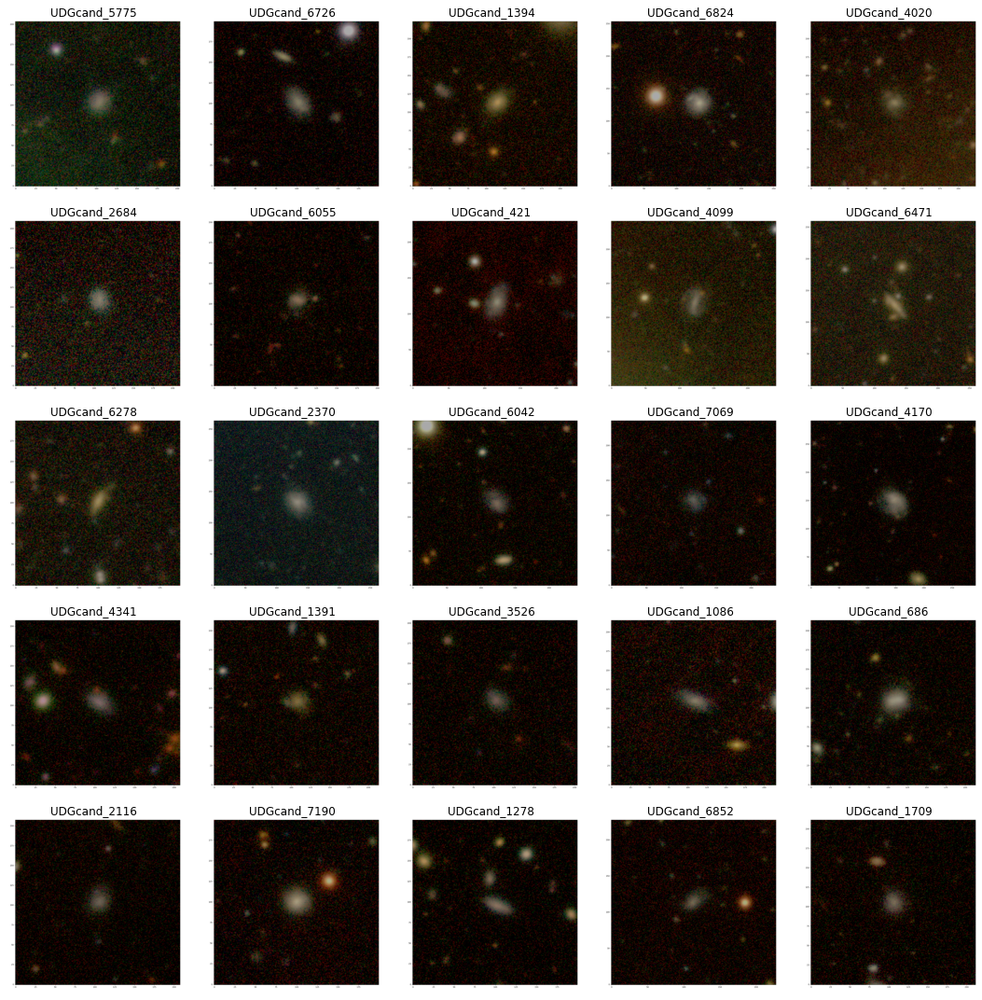

In [272]:
f3 = plot_random_with_constraints(consensus_fluffy, 5, 5)

In [291]:
mf3 = np.array([13, 17, 20, 23, 24])

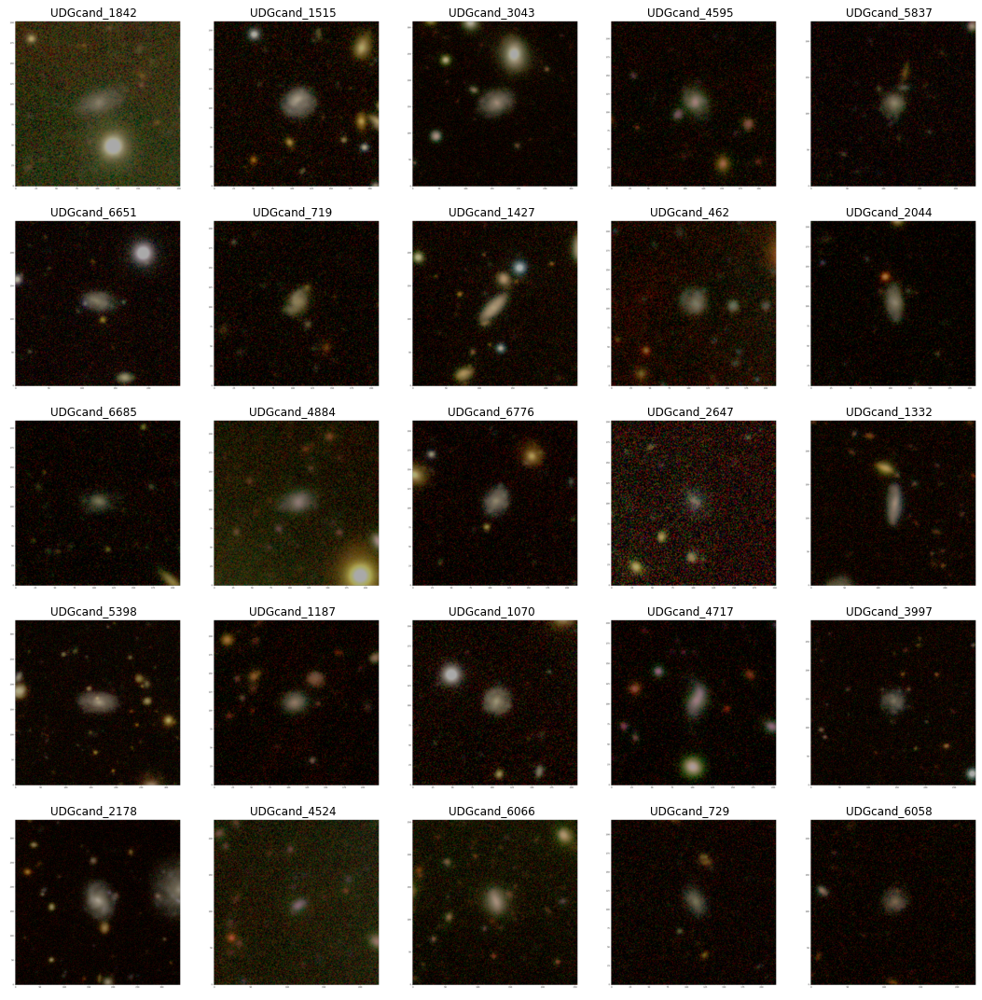

In [273]:
f4 = plot_random_with_constraints(consensus_fluffy, 5, 5)

In [292]:
mf4 = np.array([24])

In [396]:
sample = combine_slices([f1, f2, f3, f4])
sample_my_votes = np.concatenate([mf1, mf2, mf3, mf4])

sample.query('name.isin(@catalogue_targets)')

catalogue_fluffies = np.where(sample['name'].isin(catalogue_targets))

In [375]:
mf2 += 25
mf3 += 50
mf4 += 75

my_fluffies = np.concatenate([mf1, mf2, mf3, mf4])

In [376]:
correct = set(list(my_fluffies)) & set(list(catalogue_fluffies[0]))

print(len(my_fluffies), len(catalogue_fluffies[0]))
print(len(correct)/len(set(my_fluffies)))

not_found = 0
for obj in list(catalogue_fluffies[0]):
    if not obj in list(my_fluffies):
        not_found += 1
        
print(not_found)

11 4
0.0
4


I classified 11 objects as fluffy. Only 4 of those are actually fluffy: of all the objects I classify as fluffy, 36.36% are actually in the catalogue.

I made 0 false negative classifications.

Of the objects in the sample that are in the catalogue, there were 0 that I didn't identify as fluffies.

I forgot the seeds of randomness. What follows is a list of object names:

['UDGcand_2621',
 'UDGcand_3185',
 'UDGcand_2828',
 'UDGcand_5082',
 'UDGcand_845',
 'UDGcand_337',
 'UDGcand_4066',
 'UDGcand_4254',
 'UDGcand_4483',
 'UDGcand_2919',
 'UDGcand_686',
 'UDGcand_7190',
 'UDGcand_3754',
 'UDGcand_913',
 'UDGcand_4725',
 'UDGcand_4595',
 'UDGcand_4770',
 'UDGcand_859',
 'UDGcand_4697',
 'UDGcand_6789',
 'UDGcand_1633',
 'UDGcand_4949',
 'UDGcand_1680',
 'UDGcand_188',
 'UDGcand_2280',
 'UDGcand_5',
 'UDGcand_1699',
 'UDGcand_101',
 'UDGcand_5151',
 'UDGcand_2446',
 'UDGcand_1033',
 'UDGcand_5762',
 'UDGcand_5241',
 'UDGcand_1410',
 'UDGcand_1121',
 'UDGcand_4227',
 'UDGcand_2855',
 'UDGcand_925',
 'UDGcand_3476',
 'UDGcand_5124',
 'UDGcand_4828',
 'UDGcand_1331',
 'UDGcand_1451',
 'UDGcand_5983',
 'UDGcand_1070',
 'UDGcand_6329',
 'UDGcand_434',
 'UDGcand_531',
 'UDGcand_1036',
 'UDGcand_6055',
 'UDGcand_5775',
 'UDGcand_6726',
 'UDGcand_1394',
 'UDGcand_6824',
 'UDGcand_4020',
 'UDGcand_2684',
 'UDGcand_6055',
 'UDGcand_421',
 'UDGcand_4099',
 'UDGcand_6471',
 'UDGcand_6278',
 'UDGcand_2370',
 'UDGcand_6042',
 'UDGcand_7069',
 'UDGcand_4170',
 'UDGcand_4341',
 'UDGcand_1391',
 'UDGcand_3526',
 'UDGcand_1086',
 'UDGcand_686',
 'UDGcand_2116',
 'UDGcand_7190',
 'UDGcand_1278',
 'UDGcand_6852',
 'UDGcand_1709',
 'UDGcand_1842',
 'UDGcand_1515',
 'UDGcand_3043',
 'UDGcand_4595',
 'UDGcand_5837',
 'UDGcand_6651',
 'UDGcand_719',
 'UDGcand_1427',
 'UDGcand_462',
 'UDGcand_2044',
 'UDGcand_6685',
 'UDGcand_4884',
 'UDGcand_6776',
 'UDGcand_2647',
 'UDGcand_1332',
 'UDGcand_5398',
 'UDGcand_1187',
 'UDGcand_1070',
 'UDGcand_4717',
 'UDGcand_3997',
 'UDGcand_2178',
 'UDGcand_4524',
 'UDGcand_6066',
 'UDGcand_729',
 'UDGcand_6058']

--- 
Again, for completeness

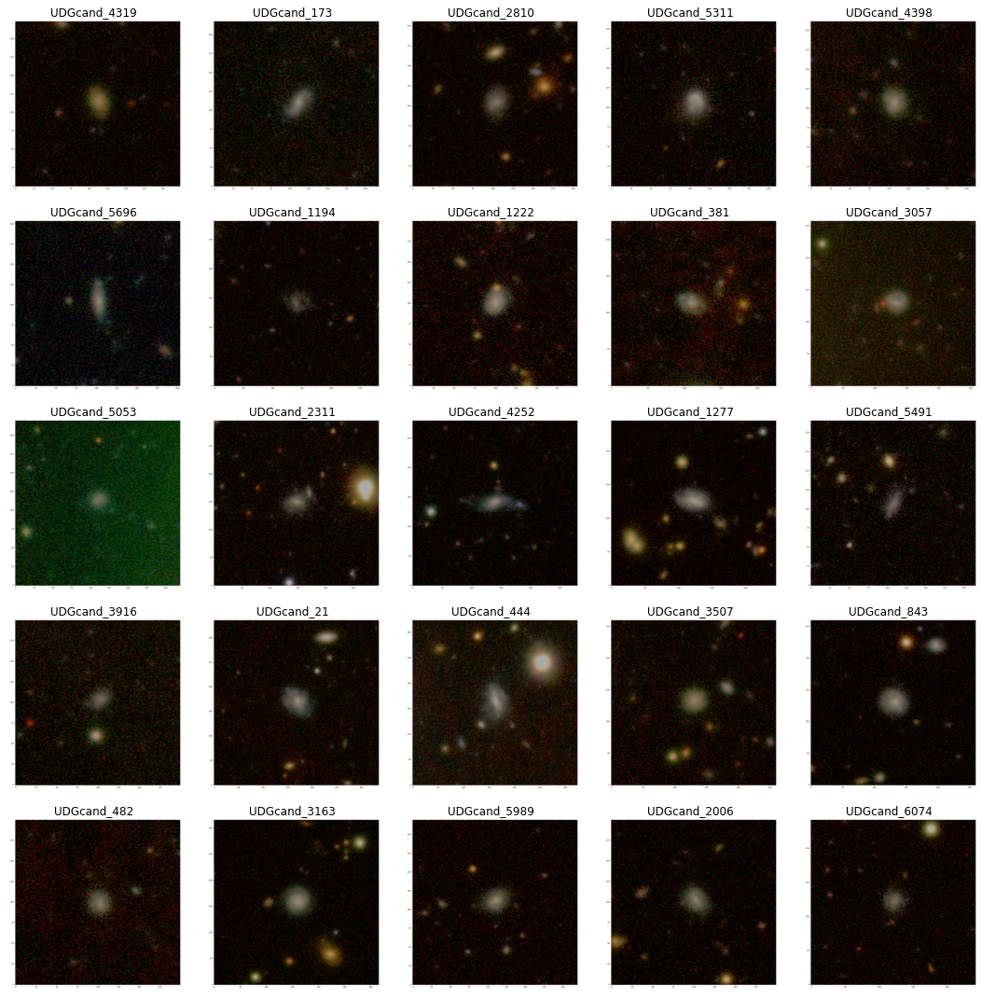

In [338]:
f5 = plot_random_with_constraints(consensus_fluffy, 5, 5)

In [365]:
mf5 = np.array([6])

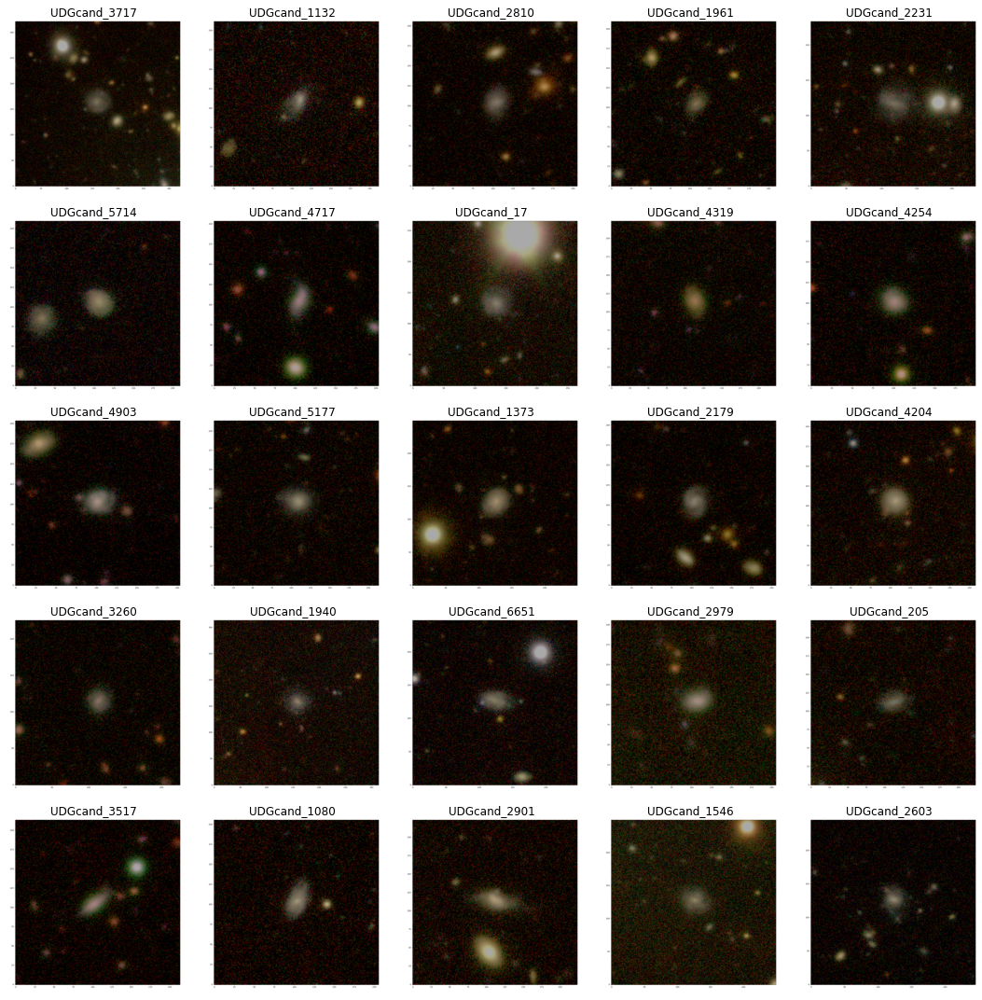

In [339]:
f6 = plot_random_with_constraints(consensus_fluffy, 5, 5)

In [366]:
mf6 = np.array([])

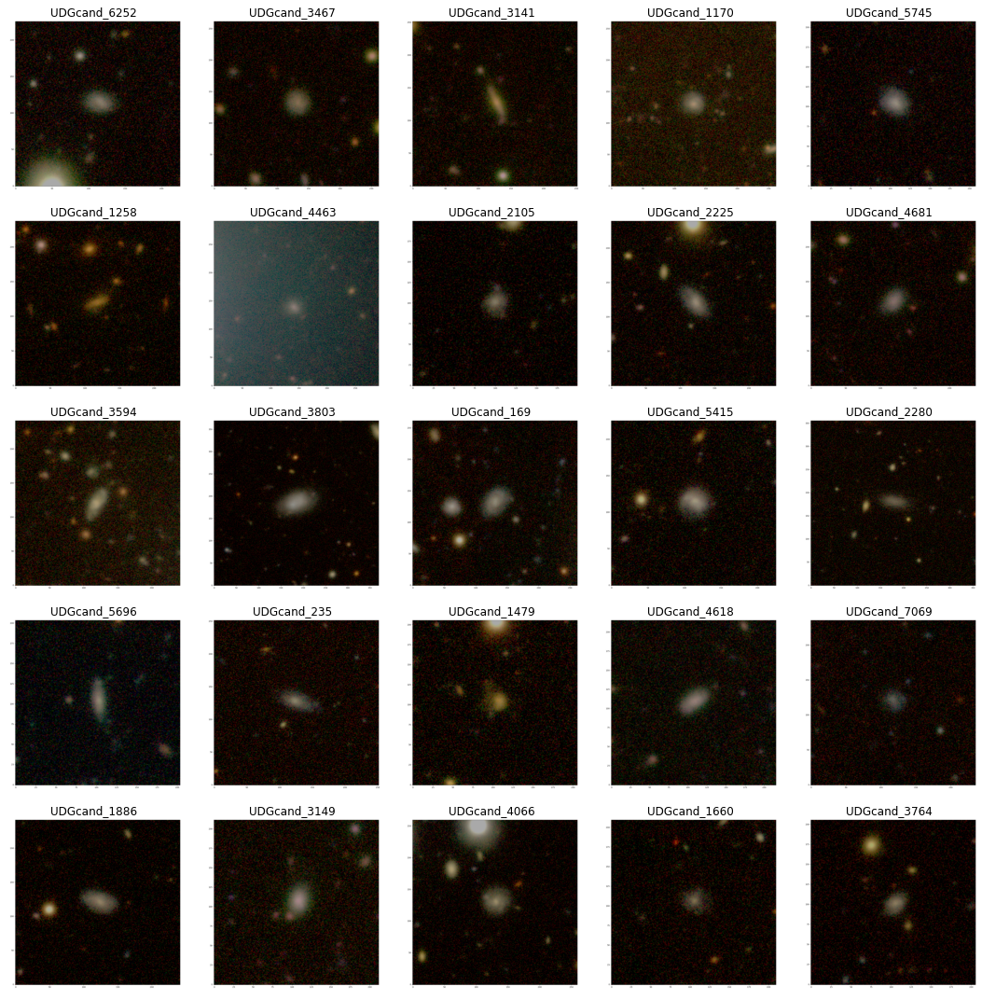

In [340]:
f7 = plot_random_with_constraints(consensus_fluffy, 5, 5)

In [367]:
mf7 = np.array([14, 19])

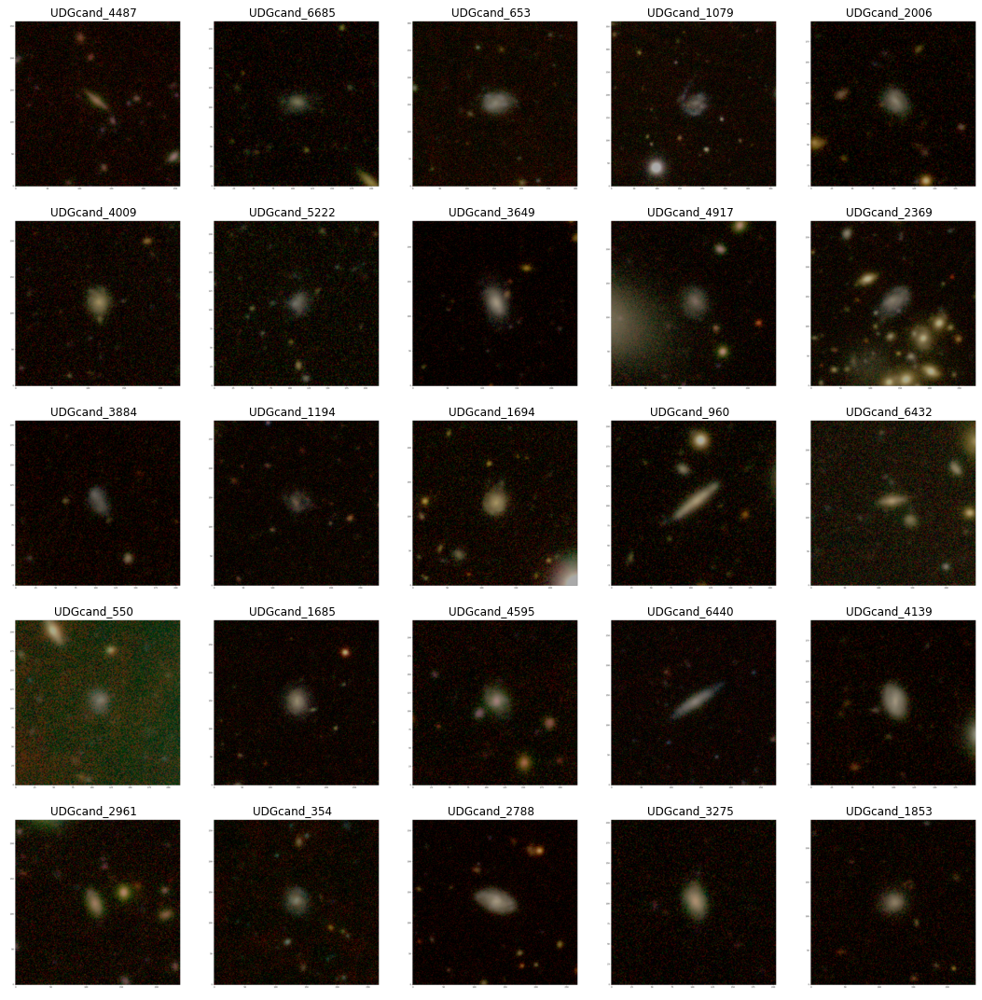

In [341]:
f8 = plot_random_with_constraints(consensus_fluffy, 5, 5)

In [368]:
mf8 = np.array([10, 11])

In [398]:
sample = combine_slices([f5, f6, f7, f8])
mf6 += 25
mf7 += 50
mf8 += 75
my_fluffies = np.concatenate([mf5, mf6, mf7, mf8])
catalogue_fluffies = np.where(sample['name'].isin(catalogue_targets))

In [370]:
sample.query('name.isin(@catalogue_targets)')

,name,vote_count,T0,T0 % group of objects (cluster),T0 % galaxy,T0 % something else/empty center,T1,T1 % bright,T1 % fluffy
5871,UDGcand_4681,35,"{'galaxy': 32, 'group of objects (cluster)': 3}",8.6,91.4,0.0,{'Fluffy': 23},0.0,100.0


In [373]:
set(list(my_fluffies)), set(list(catalogue_fluffies[0]))

({6.0, 64.0, 69.0, 85.0, 86.0}, {59})

In [372]:
correct = set(list(my_fluffies)) & set(list(catalogue_fluffies[0]))

print(len(correct)/len(set(my_fluffies)))

not_found = 0
for obj in list(catalogue_fluffies[0]):
    if not obj in list(my_fluffies):
        not_found += 1
        
print(not_found)

0.0
1


In this set, there was 1 catalogue target present. I did not identify it as a fluffy.
I did idenfity 6 objects as fluffies, none of which are in the catalogue.

In [377]:
TP = 4
FP = 6+7
FN = 1
TN = 200-6+11

In [382]:
sensitivity = TP/(TP+FN)
specificity = TN/(TN+FP)
ppv = TP/(TP+FP)
npv = TN/(TN+FN)
sensitivity, specificity, ppv, npv

(0.8, 0.9403669724770642, 0.23529411764705882, 0.9951456310679612)

In [404]:
mcc(TP, TN, FP, FN), acc(TP, TN, FP, FN), f1(FP, FN, TP)

(0.41304960851514533, 0.9372197309417041, 0.36363636363636365)

I forgot to specify the seeds for the random draws, so for posterity, here are the objects shown, in order:

array(['UDGcand_4319', 'UDGcand_173', 'UDGcand_2810', 'UDGcand_5311',
       'UDGcand_4398', 'UDGcand_5696', 'UDGcand_1194', 'UDGcand_1222',
       'UDGcand_381', 'UDGcand_3057', 'UDGcand_5053', 'UDGcand_2311',
       'UDGcand_4252', 'UDGcand_1277', 'UDGcand_5491', 'UDGcand_3916',
       'UDGcand_21', 'UDGcand_444', 'UDGcand_3507', 'UDGcand_843',
       'UDGcand_482', 'UDGcand_3163', 'UDGcand_5989', 'UDGcand_2006',
       'UDGcand_6074', 'UDGcand_3717', 'UDGcand_1132', 'UDGcand_2810',
       'UDGcand_1961', 'UDGcand_2231', 'UDGcand_5714', 'UDGcand_4717',
       'UDGcand_17', 'UDGcand_4319', 'UDGcand_4254', 'UDGcand_4903',
       'UDGcand_5177', 'UDGcand_1373', 'UDGcand_2179', 'UDGcand_4204',
       'UDGcand_3260', 'UDGcand_1940', 'UDGcand_6651', 'UDGcand_2979',
       'UDGcand_205', 'UDGcand_3517', 'UDGcand_1080', 'UDGcand_2901',
       'UDGcand_1546', 'UDGcand_2603', 'UDGcand_6252', 'UDGcand_3467',
       'UDGcand_3141', 'UDGcand_1170', 'UDGcand_5745', 'UDGcand_1258',
       'UDGcand_4463', 'UDGcand_2105', 'UDGcand_2225', 'UDGcand_4681',
       'UDGcand_3594', 'UDGcand_3803', 'UDGcand_169', 'UDGcand_5415',
       'UDGcand_2280', 'UDGcand_5696', 'UDGcand_235', 'UDGcand_1479',
       'UDGcand_4618', 'UDGcand_7069', 'UDGcand_1886', 'UDGcand_3149',
       'UDGcand_4066', 'UDGcand_1660', 'UDGcand_3764', 'UDGcand_4487',
       'UDGcand_6685', 'UDGcand_653', 'UDGcand_1079', 'UDGcand_2006',
       'UDGcand_4009', 'UDGcand_5222', 'UDGcand_3649', 'UDGcand_4917',
       'UDGcand_2369', 'UDGcand_3884', 'UDGcand_1194', 'UDGcand_1694',
       'UDGcand_960', 'UDGcand_6432', 'UDGcand_550', 'UDGcand_1685',
       'UDGcand_4595', 'UDGcand_6440', 'UDGcand_4139', 'UDGcand_2961',
       'UDGcand_354', 'UDGcand_2788', 'UDGcand_3275', 'UDGcand_1853'],
      dtype=object)